In [1]:
%matplotlib inline
import os
import glob

import cv2
from osgeo import gdal
from pyproj import Proj, transform

import seaborn as sns
sns.set_style('white')

from pprint import pprint
import numpy as np
import pandas as pd
from planet import api
import matplotlib.colors
import matplotlib.pyplot as plt
from pysurvey.plot import setup_sns as setup
plt.rc('axes.formatter', useoffset=False)


/Users/ajmendez/.local/canopy/User/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')
/Users/ajmendez/.local/canopy/User/lib/python2.7/site-packages/matplotlib/__init__.py:872: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


In [240]:
import skimage
import skimage.exposure

In [34]:
inproj = Proj(init='EPSG:3857')
outproj = Proj(init='epsg:4326')

def pixel2coord(ds, col, row):
    """Returns global coordinates to pixel center using base-0 raster index"""
    c, a, b, f, d, e = ds.GetGeoTransform()
    xp = a * col + b * row + a * 0.5 + b * 0.5 + c
    yp = d * col + e * row + d * 0.5 + e * 0.5 + f
#     return(xp, yp)
    return transform(inproj,outproj,xp,yp)
filename = ds.GetDescription()
print pixel2coord(ds, 0,0)
!gdalinfo $filename

(-117.42185352596306, 32.99021755771188)
Driver: GTiff/GeoTIFF
Files: /Users/ajmendez/tmp/world/california/mosaics/open_california_re_20140301_20140531/L15-0356E-1222N.tif
Size is 4096, 4096
Coordinate System is:
PROJCS["WGS 84 / Pseudo-Mercator",
    GEOGCS["WGS 84",
        DATUM["WGS_1984",
            SPHEROID["WGS 84",6378137,298.257223563,
                AUTHORITY["EPSG","7030"]],
            AUTHORITY["EPSG","6326"]],
        PRIMEM["Greenwich",0],
        UNIT["degree",0.0174532925199433],
        AUTHORITY["EPSG","4326"]],
    PROJECTION["Mercator_1SP"],
    PARAMETER["central_meridian",0],
    PARAMETER["scale_factor",1],
    PARAMETER["false_easting",0],
    PARAMETER["false_northing",0],
    UNIT["metre",1,
        AUTHORITY["EPSG","9001"]],
    EXTENSION["PROJ4","+proj=merc +a=6378137 +b=6378137 +lat_ts=0.0 +lon_0=0.0 +x_0=0.0 +y_0=0 +k=1.0 +units=m +nadgrids=@null +wktext  +no_defs"],
    AUTHORITY["EPSG","3857"]]
Origin = (-13071343.331169698387384,3894007.9684254452586

Driver: GTiff/GeoTIFF
Files: /Users/ajmendez/tmp/world/california/mosaics/open_california_re_20140301_20140531/L15-0356E-1222N.tif
Size is 4096, 4096
Coordinate System is:
PROJCS["WGS 84 / Pseudo-Mercator",
    GEOGCS["WGS 84",
        DATUM["WGS_1984",
            SPHEROID["WGS 84",6378137,298.257223563,
                AUTHORITY["EPSG","7030"]],
            AUTHORITY["EPSG","6326"]],
        PRIMEM["Greenwich",0],
        UNIT["degree",0.0174532925199433],
        AUTHORITY["EPSG","4326"]],
    PROJECTION["Mercator_1SP"],
    PARAMETER["central_meridian",0],
    PARAMETER["scale_factor",1],
    PARAMETER["false_easting",0],
    PARAMETER["false_northing",0],
    UNIT["metre",1,
        AUTHORITY["EPSG","9001"]],
    EXTENSION["PROJ4","+proj=merc +a=6378137 +b=6378137 +lat_ts=0.0 +lon_0=0.0 +x_0=0.0 +y_0=0 +k=1.0 +units=m +nadgrids=@null +wktext  +no_defs"],
    AUTHORITY["EPSG","3857"]]
Origin = (-13071343.331169698387384,3894007.968425445258617)
Pixel Size = (4.777314267160000,-4.77

In [102]:
def load_images(filename):
    ds = gdal.Open(filename)
    rgb = [ds.GetRasterBand(i+1) for i in range(4)]
    arr = [band.ReadAsArray() for band in rgb]
    rgb = np.dstack(arr)
    
    im = cv2.imread(filename)
    imgray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

    
    return (ds, rgb, imgray)
    
    
filenames = glob.glob("/Users/ajmendez/tmp/world/california/mosaics/*/*.tif")
images = []
for filename in filenames:
    images.append(load_images(filename))
print 'Found: {}'.format(len(images))

Found: 8


7

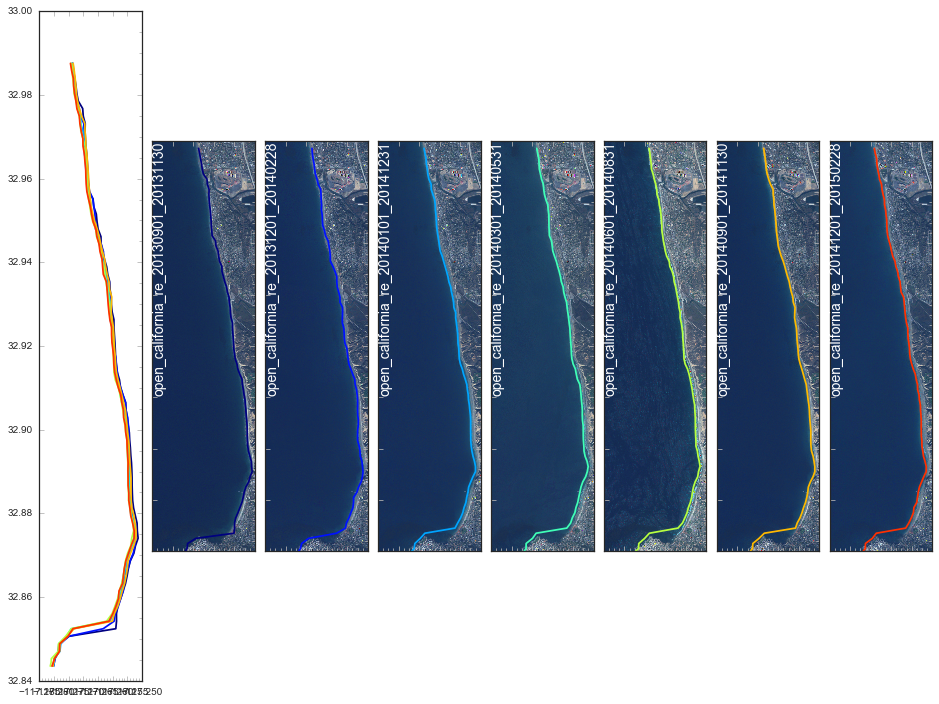

In [138]:
def chunks(l, n, step=None):
    """Yield successive n-sized chunks from l."""
    if step is None:
        step = n
    i = 0
    while i < len(l):
        yield l[i:i+n]
        i += step
        
#     for i in range(0, len(l), n):
#         yield l[i:i+n]


nshow = 7
npixels = 150
nstep = 50
tcut = 10
pcut = 95
plim = 4
plt.figure(figsize=(16,12))
norm = matplotlib.colors.Normalize(0,256*256*0.5)
coastline = []
for j, (ds, rgb, gray) in enumerate(images):
    if j > nshow-1:
        break
    mosaic = os.path.basename(os.path.dirname(ds.GetDescription()))
    threshold = int(np.percentile(gray[gray>10], pcut))
    ret,thresh = cv2.threshold(gray, threshold, 255, 0)
    
    out = []
    for i, index in enumerate(chunks(range(thresh.shape[0]), npixels, nstep)):
        tmp = thresh[index,:]
        if max(tmp.flatten()) > 0:
            pts = np.argwhere(tmp.mean(axis=0) > tcut)
            if len(pts) == 0:
                continue
            x = zip(*pts)[0]
            xmin = np.min(x)
            xmin = np.percentile(x, plim)
            out.append([xmin, np.mean(index)])
#             lon,lat = pixel2coord(ds, np.mean(x), np.mean(index))
#             out.append([lon,lat])
    
    
#     plt.hist(gray[gray>10], np.linspace(0,255, 100))
#     plt.axvline(threshold, color='orange')

    color = plt.cm.jet(j*1.0/nshow)
    ax = setup(subplt=(1,nshow+1,j+2), 
#                title=mosaic,
               xr=[3000,4000],
               yr=[4000, 0], 
               yticks=False, xticks=False)
    ax.imshow(norm(rgb))
    ax.text(0, 1, mosaic, ha='left', va='top', rotation=90, 
            transform=ax.transAxes, fontsize=14, color='w')
    x,y = zip(*out)
    ax.plot(x, y, color=color)
#     plt.gca().set(xlim=, ylim=)
    
    ax = setup(subplt=(1,nshow+1, 1))
    x,y = zip(*map(lambda x: pixel2coord(ds, x[0], x[1]), out))
    ax.plot(x, y, color=color)
    coastline.append([x,y])

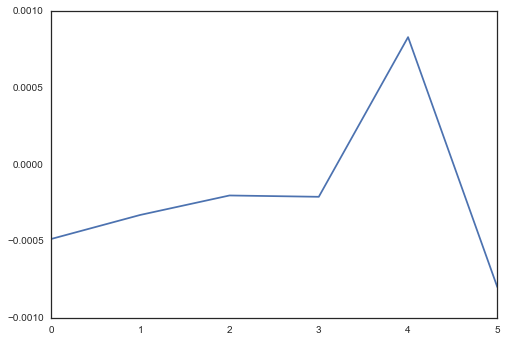

In [139]:
plt.plot(np.mean((np.diff(X, axis=0)[:,0,:]),axis=1))

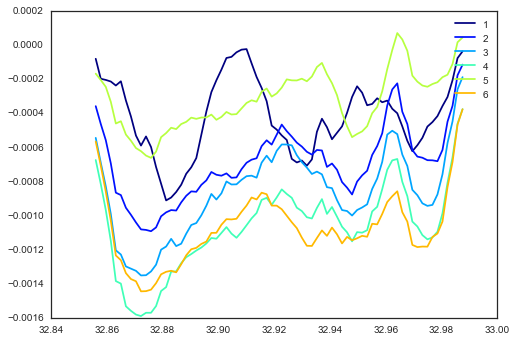

In [149]:
nsmooth = 9
nend = -8
X = np.array(coastline)
deltas = np.zeros(X.shape[0])
for i in range(X.shape[0]-1):
    D = X[i+1, 0, :nend]-X[0, 0, :nend]
    deltas[i] = np.mean(D)
    D = np.convolve(D, np.ones(nsmooth)/nsmooth, mode='same')
    plt.plot(X[i, 1, :nend], D, label=i+1,
             color=plt.cm.jet(i*1.0/X.shape[0]))
plt.legend()

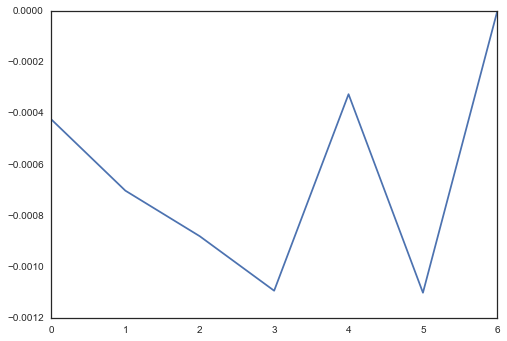

In [150]:
plt.plot(deltas)

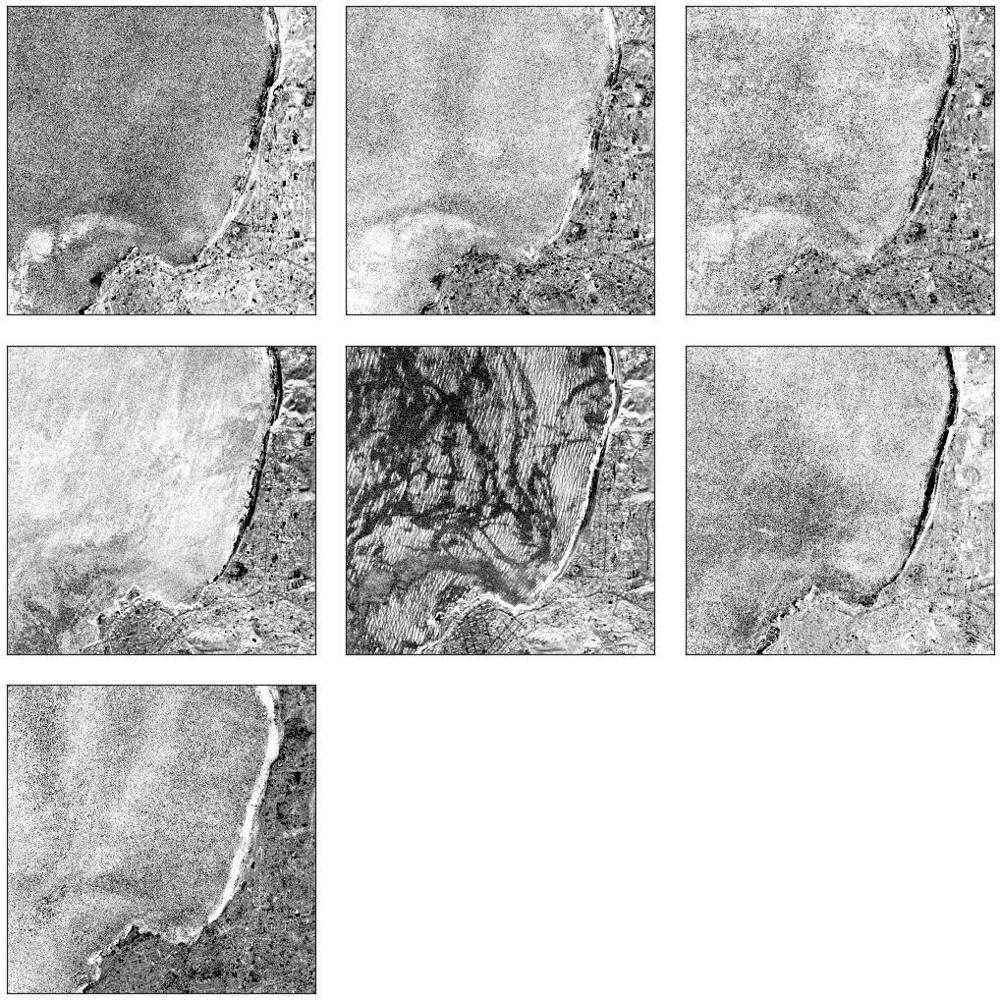

In [218]:
plt.figure(figsize=(18,18))

for i in range(len(images)-1):
    A = images[ i][1][3000:,3000:,0]
    B = images[-1][1][3000:,3000:,0]
    X = B/(1.0+A) - 1.0
    # X = cv2.GaussianBlur(X, (100,100), 1)
    X = cv2.GaussianBlur(X,(5,5),1)

    norm = matplotlib.colors.Normalize(*np.percentile(X,[2,99]), clip=True)
    # norm = matplotlib.colors.Normalize(np.min(X), np.percentile(X, 90), clip=True)
    
    setup(subplt=(3,3,i+1), xticks=False, yticks=False)
#     plt.imshow(norm(X[0:1000, 3000:4000]))
    plt.imshow(norm(X))
    # plt.imshow(np.ma.MaskedArray(X, X > 0))

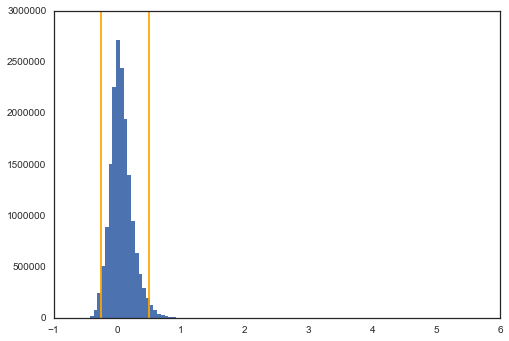

In [181]:
_ = plt.hist(X.flatten(), 100, lw=0)
for x in np.percentile(X.flatten(), [2,98]):
    plt.axvline(x, color='orange')

NameError: name 'costline' is not defined

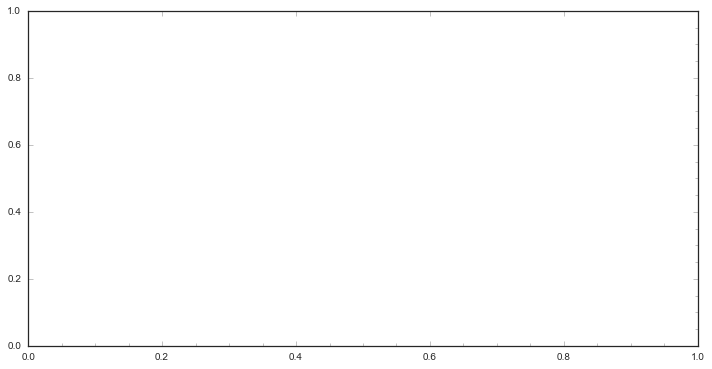

In [200]:
setup(figsize=(12,6))
out = np.zeros((len(coastline), len(costline[0]), 2))
for (x,y) in coastline:
    plt.plot(y,x, '.')
    print len(x), len(y)

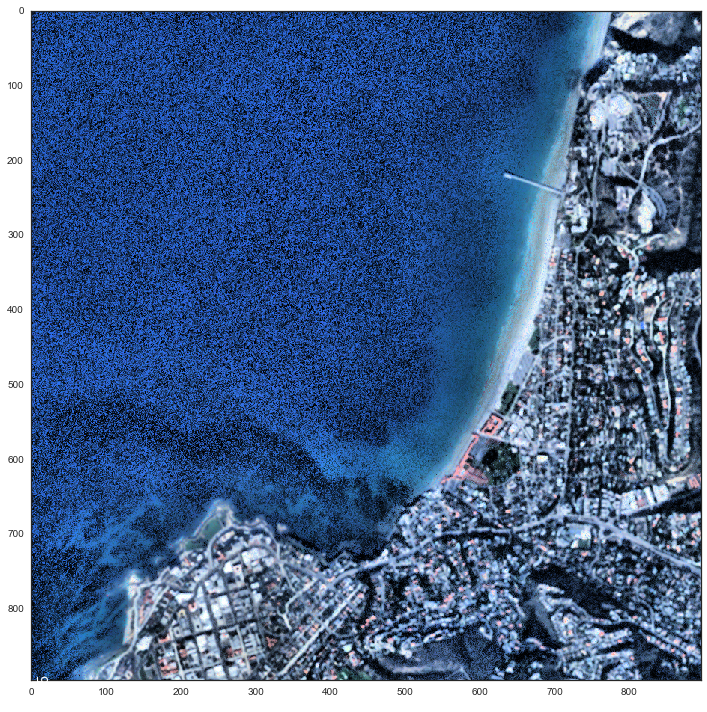

In [255]:
rgb = images[-1][1][3200:, 3200:, :-1]
plt.figure(figsize=(12,12))
norm = matplotlib.colors.Normalize(0, 256*256*0.3, clip=True)
rgb = skimage.exposure.equalize_adapthist(norm(rgb), clip_limit=0.1)
year = os.path.basename(os.path.dirname(ds.GetDescription())).split('_')[3][:4]

ax = plt.gca()
plt.imshow(rgb, 
           interpolation='nearest', cmap=plt.cm.jet)
plt.text(0.01,0.01, year, rotation=90, 
         fontsize=14, va='top', ha='left', color='w', 
        transform=ax.transAxes)

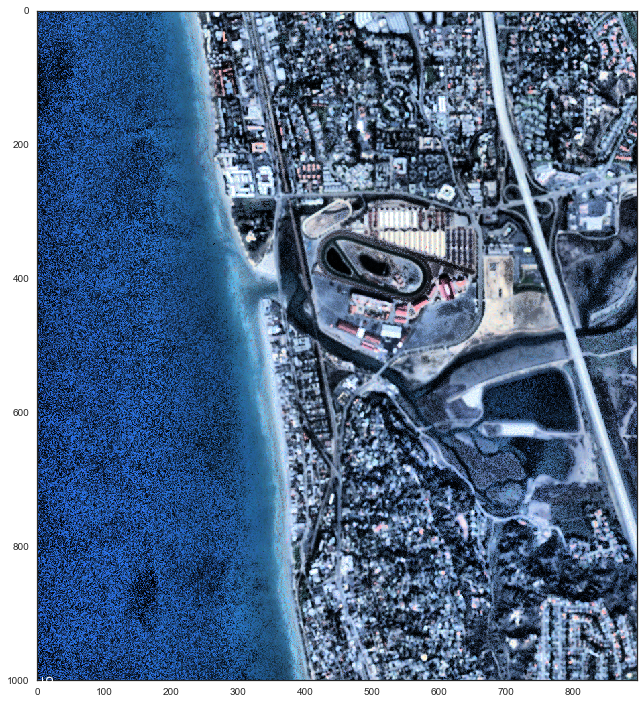

In [323]:
rgb = images[-1][1][0:1000, 3200:, :-1]
plt.figure(figsize=(12,12))
norm = matplotlib.colors.Normalize(0, 256*256*0.3, clip=True)
rgb = skimage.exposure.equalize_adapthist(norm(rgb), clip_limit=0.1)
year = os.path.basename(os.path.dirname(ds.GetDescription())).split('_')[3][:4]

ax = plt.gca()
plt.imshow(rgb, 
           interpolation='nearest', cmap=plt.cm.jet)
plt.text(0.01,0.01, year, rotation=90, 
         fontsize=14, va='top', ha='left', color='w', 
        transform=ax.transAxes)

In [289]:
from pysurvey.plot import setup as setup_doc

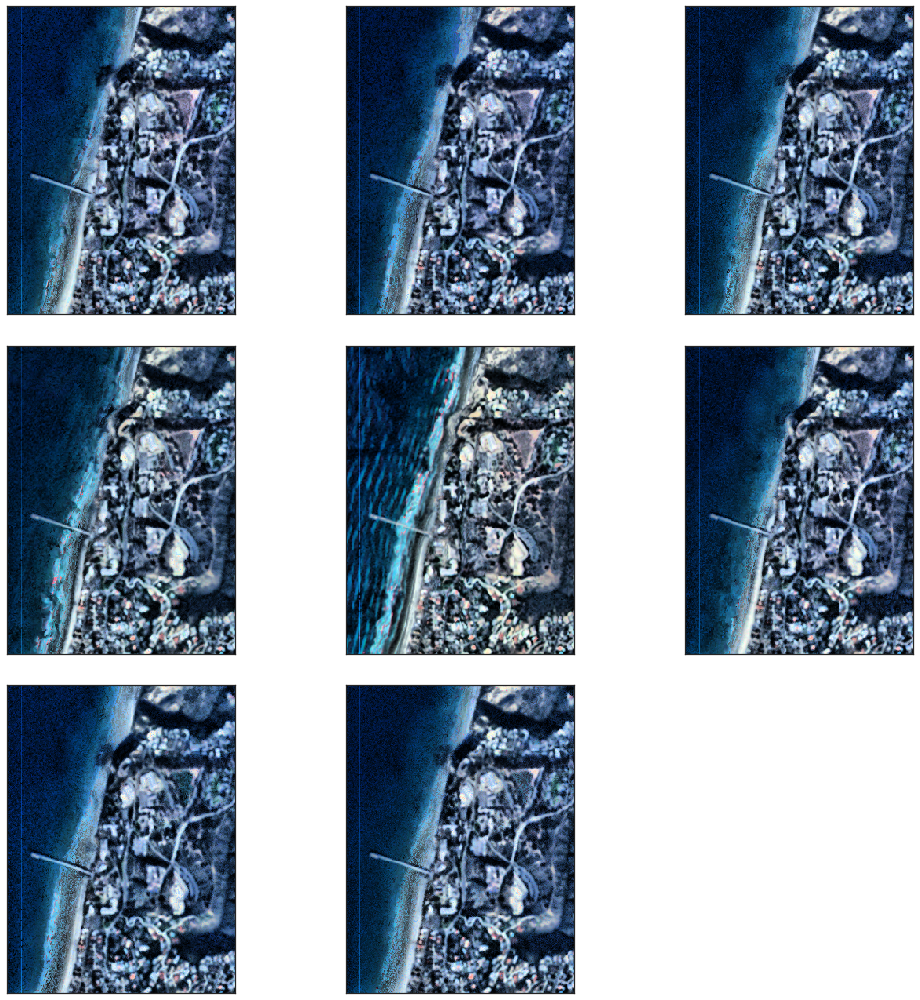

In [304]:
plt.figure(figsize=(18,18))

for i in range(len(images)):
    A = images[ i][1][3200:3600,3800:,:]
#     B = images[i+1][1][3500:,3500:,:]
#     X = B/(1.0+A) - 1.0
    # X = cv2.GaussianBlur(X, (100,100), 1)
#     X = cv2.GaussianBlur(X,(5,5),1)
#     X = cv2.bilateralFilter(X.astype(np.float32), 9, 75, 75)
#     X = cv2.dilate(X, (100,100))
#     print(np.percentile(X,[2,99]))
    X = A
    norm = matplotlib.colors.Normalize(0, 255*255*0.5, clip=True)
#     X = norm(X)
    
    norm = matplotlib.colors.Normalize(*np.percentile(X,[1,99]), clip=True)
    X = skimage.exposure.equalize_adapthist(norm(X), clip_limit=0.03)
    
    # norm = matplotlib.colors.Normalize(np.min(X), np.percentile(X, 90), clip=True)
#     setup_doc()
    setup(subplt=(3,3,i+1), xticks=False, yticks=False, tickmarks=False)
#     plt.imshow(norm(X[0:1000, 3000:4000]))
    plt.xticks([])
    plt.yticks([])
    plt.imshow(X, interpolation='nearest')
    plt.grid('off')
    # plt.imshow(np.ma.MaskedArray(X, X > 0))
#     break

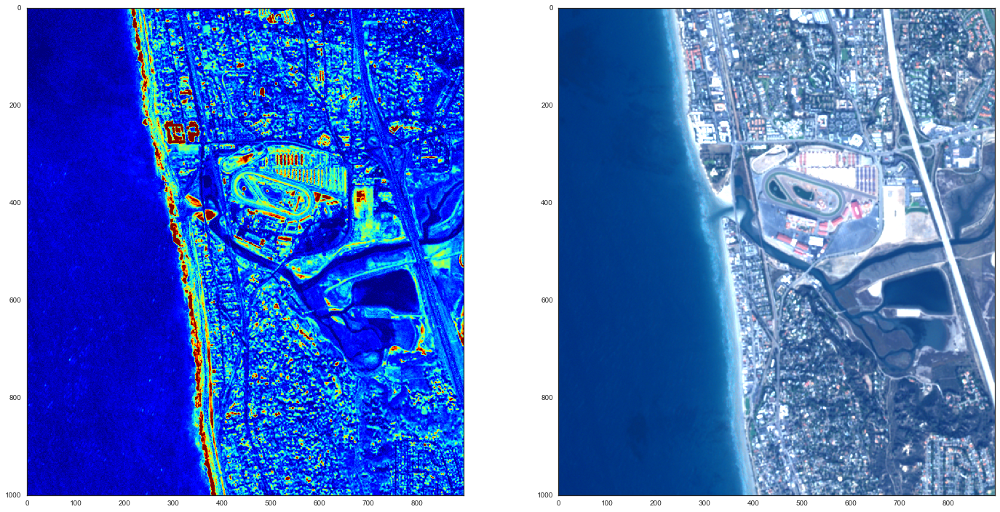

In [326]:
# tmp = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
# tmp = np.mean([i[1][3200:3600,3200:,:-1] for i in images], axis=0)
tmp = np.mean(np.std([i[1][0:1000,3200:,:-1] for i in images], axis=0), axis=2)
norm = matplotlib.colors.Normalize(*np.percentile(tmp, [1,99]), clip=True)

tmp2 = np.mean([i[1][0:1000,3200:,:-1] for i in images], axis=0)
norm2 = matplotlib.colors.Normalize(*np.percentile(tmp2, [5,95]), clip=True)
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(24,12))
ax1.imshow(norm(tmp), interpolation='nearest', cmap=plt.cm.jet)
ax2.imshow(norm2(tmp2), interpolation='nearest')

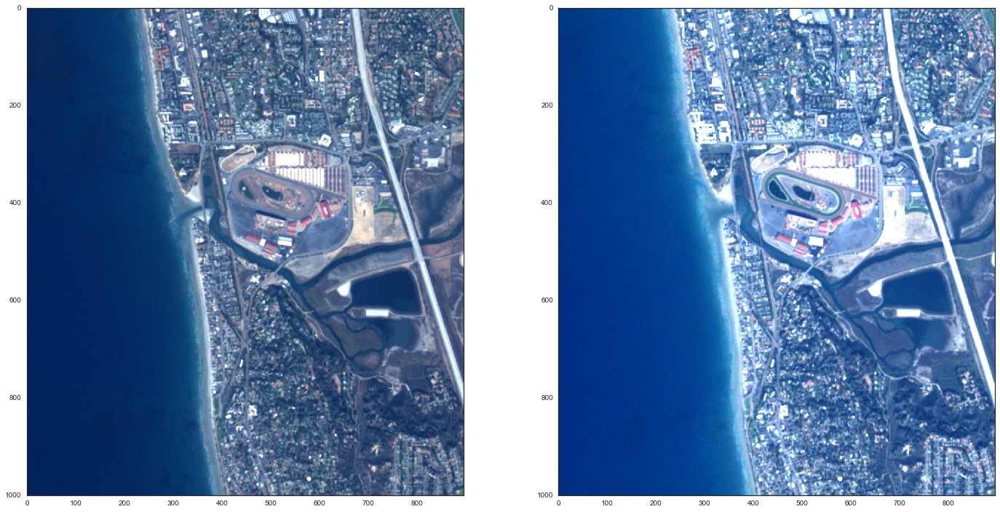

In [327]:
# tmp = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
# tmp = np.mean([i[1][3200:3600,3200:,:-1] for i in images], axis=0)
tmp = images[0][1][0:1000,3200:,:-1]
norm = matplotlib.colors.Normalize(*np.percentile(tmp, [1,99]), clip=True)


tmp2 = images[-1][1][0:1000,3200:,:-1]
norm2 = matplotlib.colors.Normalize(*np.percentile(tmp2, [5,95]), clip=True)
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(24,12))
ax1.imshow(norm(tmp), interpolation='nearest', cmap=plt.cm.jet)
ax2.imshow(norm2(tmp2), interpolation='nearest')

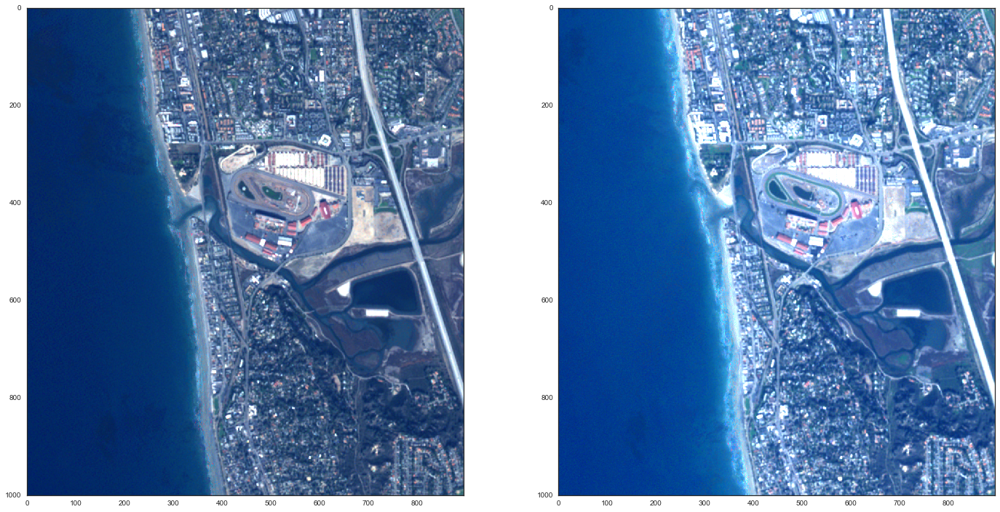

In [328]:
# tmp = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
# tmp = np.mean([i[1][3200:3600,3200:,:-1] for i in images], axis=0)
tmp = images[1][1][0:1000,3200:,:-1]
norm = matplotlib.colors.Normalize(*np.percentile(tmp, [1,99]), clip=True)


tmp2 = images[-2][1][0:1000,3200:,:-1]
norm2 = matplotlib.colors.Normalize(*np.percentile(tmp2, [5,95]), clip=True)
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(24,12))
ax1.imshow(norm(tmp), interpolation='nearest', cmap=plt.cm.jet)
ax2.imshow(norm2(tmp2), interpolation='nearest')

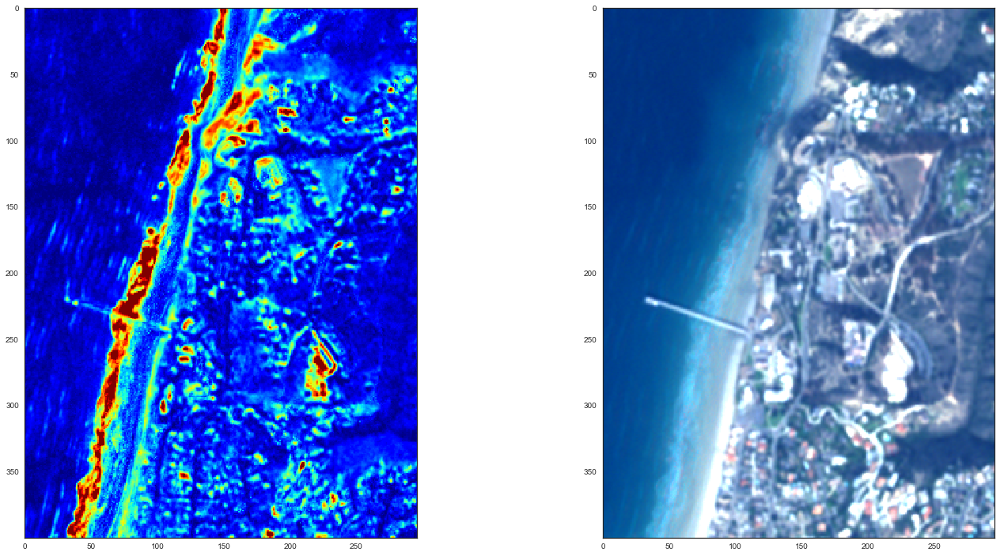

In [318]:
# tmp = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
# tmp = np.mean([i[1][3200:3600,3800:,:-1] for i in images], axis=0)
tmp = np.mean(np.std([i[1][3200:3600,3800:,:-1] for i in images], axis=0), axis=2)
norm = matplotlib.colors.Normalize(*np.percentile(tmp, [1,99]), clip=True)

tmp2 = np.mean([i[1][3200:3600,3800:,:-1] for i in images], axis=0)
norm2 = matplotlib.colors.Normalize(*np.percentile(tmp2, [5,95]), clip=True)
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(24,12))
ax1.imshow(norm(tmp), interpolation='nearest', cmap=plt.cm.jet)
ax2.imshow(norm2(tmp2), interpolation='nearest')

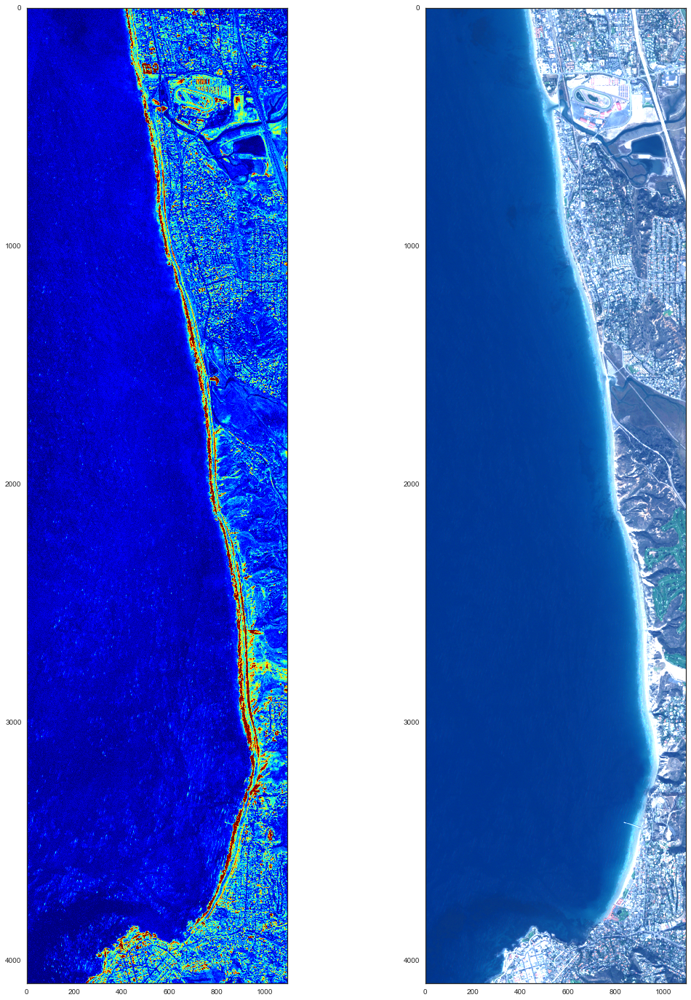

In [322]:
# tmp = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
# tmp = np.mean([i[1][3200:3600,3800:,:-1] for i in images], axis=0)
tmp = np.mean(np.std([i[1][:,3000:,:-1] for i in images], axis=0), axis=2)
norm = matplotlib.colors.Normalize(*np.percentile(tmp, [1,99]), clip=True)

tmp2 = np.mean([i[1][:,3000:,:-1] for i in images], axis=0)
norm2 = matplotlib.colors.Normalize(*np.percentile(tmp2, [5,95]), clip=True)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(18,24))
ax1.imshow(norm(tmp), interpolation='nearest', cmap=plt.cm.jet)
ax2.imshow(norm2(tmp2), interpolation='nearest')

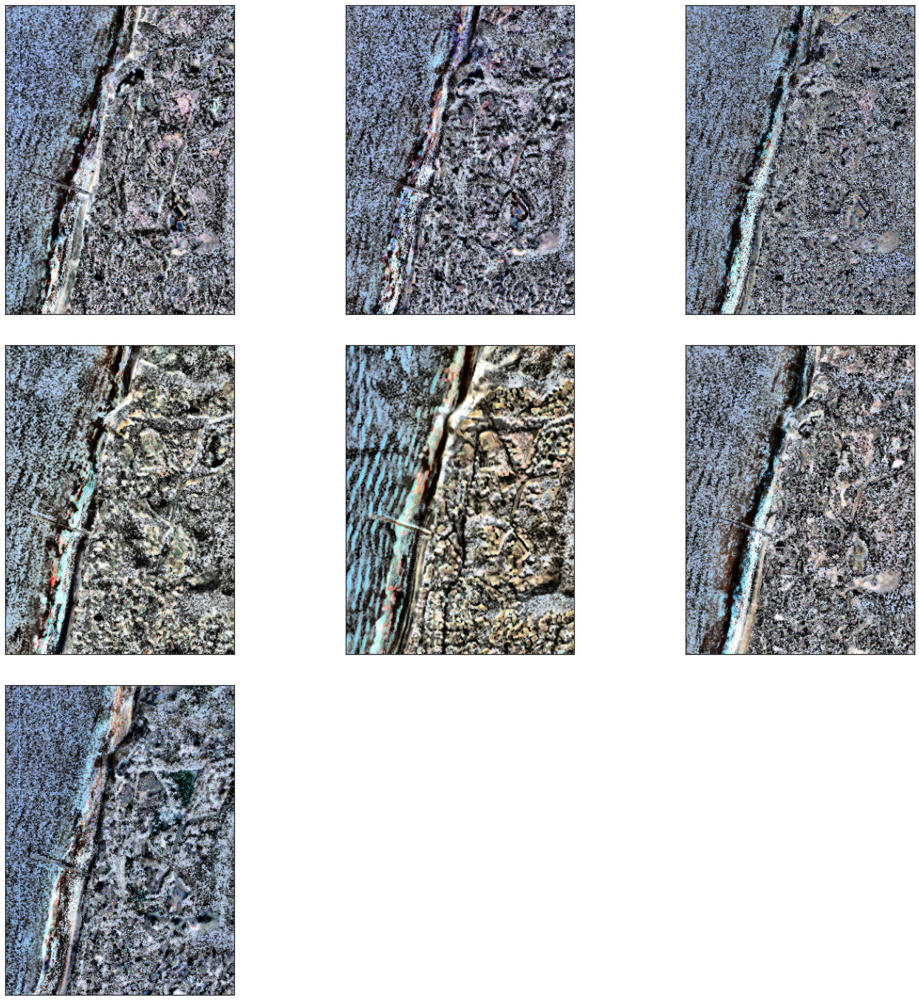

In [309]:
plt.figure(figsize=(24,24))

# B = np.mean([i[1][3200:,3200:,:-1] for i in images], axis=0)
B = np.mean([i[1][3200:3600,3800:,:-1] for i in images], axis=0)
norm = matplotlib.colors.Normalize(0, 255*255*0.5, clip=True)
B = skimage.exposure.equalize_adapthist(norm(B), clip_limit=0.03)
for i in range(len(images)-1):
#     A = images[ i][1][3200:,3200:,:-1]
    A = images[i][1][3200:3600,3800:,:-1]
    norm = matplotlib.colors.Normalize(0, 255*255*0.5, clip=True)
    A = skimage.exposure.equalize_adapthist(norm(A), clip_limit=0.03)
    
#     B = images[-1][1][3500:,3500:,:]
    X = A-B
    # X = cv2.GaussianBlur(X, (100,100), 1)
#     X = cv2.GaussianBlur(X,(5,5),1)
#     X = cv2.bilateralFilter(X.astype(np.float32), 9, 75, 75)
#     X = cv2.dilate(X, (100,100))
#     print(np.percentile(X,[2,99]))
#     X = A
#     norm = matplotlib.colors.Normalize(0, 255*255*0.5)

    norm = matplotlib.colors.Normalize(*np.percentile(X,[1,99]), clip=True)
#     X = norm(X)
    X = skimage.exposure.equalize_adapthist(norm(X), clip_limit=0.03)
    
    # norm = matplotlib.colors.Normalize(np.min(X), np.percentile(X, 90), clip=True)
    
    setup(subplt=(3,3,i+1), xticks=False, yticks=False)
#     plt.imshow(norm(X[0:1000, 3000:4000]))
    plt.imshow(X)
    # plt.imshow(np.ma.MaskedArray(X, X > 0))

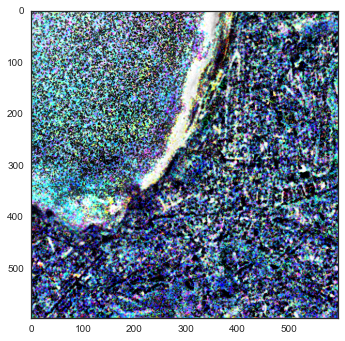

In [280]:
plt.imshow(X)

In [ ]:
# X = rgb[:,:,1]/(1.0+rgb[:,:,0])
X = rgb[:,:,2]/(1.0+rgb[:,:,0] + rgb[:,:,1])


# kernel = np.ones((5,5),np.float32)/25
# X = cv2.GaussianBlur(X,(5,5),1)
X = cv2.bilateralFilter(X.astype(np.float32), 9, 75, 10)
X = cv2.dilate(X, (100,100))

X = cv2.filter2D(X,-1,kernel)

plt.figure(figsize=(12,12))
plt.imshow(X)
# plt.imshow(np.ma.MaskedArray(rgb[:,:,0], X>0), 
#            interpolation='nearest')

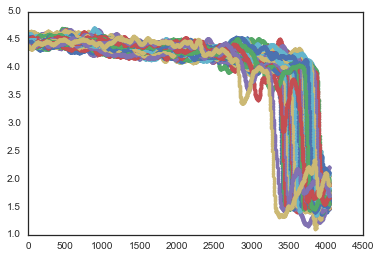

In [196]:
X = rgb[:,:,2]/(1.0+rgb[:,:,0])

for ii in chunks(range(X.shape[0]), 100):
    x = np.mean(X[ii,:], axis=0)
    x = np.convolve(x, np.ones(50)/50.0, mode='valid')
    plt.plot(x, '.')